Importing the usual suspects

In [1]:
import pandas as pd
import numpy as np
import quandl
import folium
import math
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import SparkSession
spark = SparkSession \
    .builder \
    .master("local[*]") \
    .appName('My First Spark application') \
    .getOrCreate() 

sc = spark.sparkContext

reading zillow datasets

In [2]:
# Extracting data from quandl library

# quandl.ApiConfig.api_key = ''
# reg = quandl.get_table('ZILLOW/REGIONS')

# def splitaddress(x,n):
#     try:
#         return x.split('; ')[n]
#     except:
#         return np.NaN
    
# reg['zip'] = reg.region.apply(lambda x: splitaddress(x,0))
# reg['state'] = reg.region.apply(lambda x: splitaddress(x,1))
# reg['city'] = reg.region.apply(lambda x: splitaddress(x,2))
# reg['county'] = reg.region.apply(lambda x: splitaddress(x,3))
# reg['community'] = reg.region.apply(lambda x: splitaddress(x,4))


# # Filtering CA data

# reg[reg.state == 'CA'][reg.region_type=='zip'].to_csv('ZILLOW-REGIONS_CA.csv')

# regid = pd.read_csv('ZILLOW-REGIONS_CA.csv').region_id.unique()
# print(len(regid))
# k = []
# j = 0
# for i in regid:
#     k.append(quandl.get_table('ZILLOW/DATA', region_id=i))
#     j += 1
    
# dat = pd.concat(k)

# dat.to_csv('ZILLOW-DATA_CA.csv')

In [3]:
df1 = spark.read.csv('ZILLOW-DATA_CA.csv', header = True)
df2 = spark.read.csv('ZILLOW-REGIONS_CA.csv', header = True)
df3 = spark.read.csv('ZILLOW-INDICATORS.csv', header = True)

In [4]:
df1.createOrReplaceTempView("data")
df2.createOrReplaceTempView("regions")
df3.createOrReplaceTempView("indicators")

merging them using SQL query

In [5]:
query = """
SELECT data.indicator_id, data.region_id, regions.region_type, regions.region, indicators.indicator, indicators.category, data.date, data.value
    FROM data, regions, indicators
    where data.indicator_id = indicators.indicator_id and data.region_id = regions.region_id 
    and (data.date like '2015%' or data.date like '2016%' or data.date like '2017%' or data.date like '2018%' or data.date like '2019%' or data.date like '2020%') 
"""
result = spark.sql(query)
result.show()

+------------+---------+-----------+--------------------+--------------------+-----------+----------+--------+
|indicator_id|region_id|region_type|              region|           indicator|   category|      date|   value|
+------------+---------+-----------+--------------------+--------------------+-----------+----------+--------+
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-10-31| 93747.0|
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-09-30| 91777.0|
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-08-31| 90099.0|
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-07-31| 90925.0|
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-06-30| 93164.0|
|        ZSFH|    99380|        zip|97635; CA; Modoc ...|ZHVI Single-Famil...|Home values|2020-05-31| 97663.0|
|

Converting a spark dataframe into a pandas dataframe

In [6]:
df = result.toPandas()
df.head()

,indicator_id,region_id,region_type,region,indicator,category,date,value
0,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-10-31,93747.0
1,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-09-30,91777.0
2,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-08-31,90099.0
3,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-07-31,90925.0
4,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-06-30,93164.0


In [7]:
df = df[df.category == 'Home values']
df.date = pd.to_datetime(df.date)
df = df[df.date >= pd.datetime(2017,1,1)]

C:\Users\dy090\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  This is separate from the ipykernel package so we can avoid doing imports until


extracting zipcode from the region column

In [8]:
def splitaddress(x,n):
    try:
        return x.split('; ')[n]
    except:
        return np.NaN
    
df['zip'] = df.region.apply(lambda x: splitaddress(x,0))
df['state'] = df.region.apply(lambda x: splitaddress(x,1))
df['city'] = df.region.apply(lambda x: splitaddress(x,2))
df['county'] = df.region.apply(lambda x: splitaddress(x,3))
df['community'] = df.region.apply(lambda x: splitaddress(x,4))
df.head()

,indicator_id,region_id,region_type,region,indicator,category,date,value,zip,state,city,county,community
0,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-10-31,93747.0,97635,CA,Modoc County,New Pine Creek,NaN
1,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-09-30,91777.0,97635,CA,Modoc County,New Pine Creek,NaN
2,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-08-31,90099.0,97635,CA,Modoc County,New Pine Creek,NaN
3,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-07-31,90925.0,97635,CA,Modoc County,New Pine Creek,NaN
4,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-06-30,93164.0,97635,CA,Modoc County,New Pine Creek,NaN


reading a dataset that contains the information of zipcodes tied with long and lat

In [9]:
# https://public.opendatasoft.com/explore/dataset/us-zip-code-latitude-and-longitude/table/
zipcode = pd.read_json('us-zip-code-latitude-and-longitude.json')['fields']
zipcode = pd.DataFrame(zipcode.values.tolist())
zipcode.head()

,city,zip,dst,geopoint,longitude,state,latitude,timezone
0,Eudora,66025,1,"[38.917032, -95.06455]",-95.06455,KS,38.917032,-6
1,Savanna,74565,1,"[34.831398, -95.83967]",-95.83967,OK,34.831398,-6
2,Beckville,75631,1,"[32.237924, -94.46427]",-94.46427,TX,32.237924,-6
3,Rancho Santa Fe,92067,1,"[33.016492, -117.20264]",-117.20264,CA,33.016492,-8
4,San Diego,92119,1,"[32.80225, -117.02431]",-117.02431,CA,32.802250,-8


merging them together

In [10]:
df2 = pd.merge(df, zipcode, how = 'left', on = 'zip')
df2.head()

,indicator_id,region_id,region_type,region,indicator,category,date,value,zip,state_x,city_x,county,community,city_y,dst,geopoint,longitude,state_y,latitude,timezone
0,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-10-31,93747.0,97635,CA,Modoc County,New Pine Creek,NaN,New Pine Creek,1.0,"[41.924974, -120.28989]",-120.28989,CA,41.924974,-8.0
1,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-09-30,91777.0,97635,CA,Modoc County,New Pine Creek,NaN,New Pine Creek,1.0,"[41.924974, -120.28989]",-120.28989,CA,41.924974,-8.0
2,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-08-31,90099.0,97635,CA,Modoc County,New Pine Creek,NaN,New Pine Creek,1.0,"[41.924974, -120.28989]",-120.28989,CA,41.924974,-8.0
3,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-07-31,90925.0,97635,CA,Modoc County,New Pine Creek,NaN,New Pine Creek,1.0,"[41.924974, -120.28989]",-120.28989,CA,41.924974,-8.0
4,ZSFH,99380,zip,97635; CA; Modoc County; New Pine Creek,ZHVI Single-Family Homes Time Series ($),Home values,2020-06-30,93164.0,97635,CA,Modoc County,New Pine Creek,NaN,New Pine Creek,1.0,"[41.924974, -120.28989]",-120.28989,CA,41.924974,-8.0


In [11]:
k = []
df3 = df2.copy()
df3.sort_values('date', inplace = True)
# df3.date = pd.to_datetime(df3.date)
# df3[df3.date >= pd.datetime(2015,1,1)]
df3 = df3[df3['latitude'].notnull()]
df3.value = df3.value.astype('float')
df3['value'] = df3['value'] / df3['value'].max()
days = df3.date.unique()
for i in days:
    k.append(df3[df3.date == i][['latitude','longitude','value']].values.tolist())
k[0][:10]

[[33.972914, -118.24878, 0.026567510686941995],
 [37.186872, -120.650351, 0.026035359015640535],
 [35.774967, -119.23371, 0.01797263537213774],
 [37.186872, -120.650351, 0.017457340553853607],
 [34.839964, -115.967051, 0.013232225861642584],
 [38.607756, -121.18367, 0.04174100000504696],
 [40.183837, -122.24074, 0.02184466460414154],
 [37.719581, -122.41085, 0.08822947526736281],
 [39.299405, -120.95144, 0.06239377406769995],
 [33.184028, -116.26597, 0.035821014540297465]]

In [12]:
from folium import plugins

Here I have created a heatmap of house value

In [13]:
m=folium.Map(location=[df2.latitude.mean(),df2.longitude.mean()], tiles='stamentoner', zoom_start=6)
plugins.HeatMapWithTime(k, min_speed = 30, max_speed= 35).add_to(m)
display(m)

## Crime / Population of each city
- I have downloaded the data of 2019 from https://ucr.fbi.gov/crime-in-the-u.s/2019/crime-in-the-u.s.-2019/tables/table-8/table-8-state-cuts/california.xls

In [15]:
#https://ucr.fbi.gov/crime-in-the-u.s/2019/crime-in-the-u.s.-2019/tables/table-8/table-8-state-cuts/california.xls
city_crime = pd.read_excel('california_crime.xls', skiprows = 4)
city_crime['sum'] = city_crime[city_crime.columns[2:]].sum(axis = 1)
city_crime['crime_rate'] = city_crime['sum'] / city_crime['Population']
city_crime.head()


,City,Population,Violent\ncrime,Murder and\nnonnegligent\nmanslaughter,Rape1,Robbery,Aggravated\nassault,Property\ncrime,Burglary,Larceny-\ntheft,Motor\nvehicle\ntheft,Arson,sum,crime_rate
0,Adelanto,34491.0,276.0,1.0,20.0,42.0,213.0,459.0,136.0,209.0,114.0,14.0,1484.0,0.043026
1,Agoura Hills,20490.0,21.0,0.0,6.0,4.0,11.0,306.0,66.0,223.0,17.0,0.0,654.0,0.031918
2,Alameda,78907.0,162.0,0.0,7.0,94.0,61.0,2579.0,218.0,1958.0,403.0,29.0,5511.0,0.069842
3,Albany,20083.0,40.0,0.0,8.0,21.0,11.0,685.0,105.0,534.0,46.0,1.0,1451.0,0.072250
4,Alhambra,84837.0,161.0,2.0,11.0,89.0,59.0,1749.0,259.0,1303.0,187.0,8.0,3828.0,0.045122


Since it is 2019 data, I will compare the data with the average house value starting from the year 2019.

In [27]:
df2.value = df2.value.astype('float')
grouped_df = df2[df2.date >= pd.datetime(2019,1,1)].groupby('zip') .agg({'value':('mean'), 'city_y':'first', 'indicator':'first', 'longitude':'first', 'latitude':'first'})
grouped_df.head()


C:\Users\dy090\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  


,value,city_y,indicator,longitude,latitude
zip,,,,,
90001,4.371171e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.24878,33.972914
90002,4.213992e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.24845,33.948315
90003,4.520135e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.27600,33.962714
90008,8.881012e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.33705,34.009754
90010,1.029937e+06,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.31481,34.062709


I am going to merge the crime data with our original zillow data

In [17]:
crime_df = pd.merge(grouped_df, city_crime, how = 'inner', left_on = 'city_y', right_on= 'City')
crime_df.head()

,value,city_y,indicator,longitude,latitude,City,Population,Violent\ncrime,Murder and\nnonnegligent\nmanslaughter,Rape1,Robbery,Aggravated\nassault,Property\ncrime,Burglary,Larceny-\ntheft,Motor\nvehicle\ntheft,Arson,sum,crime_rate
0,4.371171e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.24878,33.972914,Los Angeles,4015546.0,29400.0,258.0,2274.0,9652.0,17216.0,95704.0,13809.0,66253.0,15642.0,1672.0,251880.0,0.062726
1,4.213992e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.24845,33.948315,Los Angeles,4015546.0,29400.0,258.0,2274.0,9652.0,17216.0,95704.0,13809.0,66253.0,15642.0,1672.0,251880.0,0.062726
2,4.520135e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.27600,33.962714,Los Angeles,4015546.0,29400.0,258.0,2274.0,9652.0,17216.0,95704.0,13809.0,66253.0,15642.0,1672.0,251880.0,0.062726
3,8.881012e+05,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.33705,34.009754,Los Angeles,4015546.0,29400.0,258.0,2274.0,9652.0,17216.0,95704.0,13809.0,66253.0,15642.0,1672.0,251880.0,0.062726
4,1.029937e+06,Los Angeles,ZHVI Single-Family Homes Time Series ($),-118.31481,34.062709,Los Angeles,4015546.0,29400.0,258.0,2274.0,9652.0,17216.0,95704.0,13809.0,66253.0,15642.0,1672.0,251880.0,0.062726


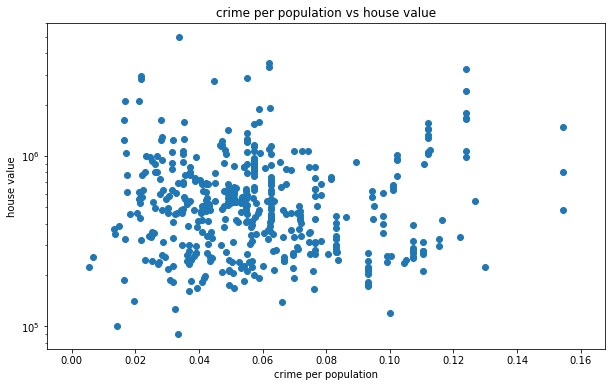

In [18]:
plt.figure(figsize = (10,6))
plt.scatter( crime_df.crime_rate, crime_df.value, label = i)
plt.xlabel('crime per population')
plt.ylabel('house value')

plt.title('crime per population vs house value')
plt.yscale('log')

Text(0.5, 1.0, 'population vs house value')

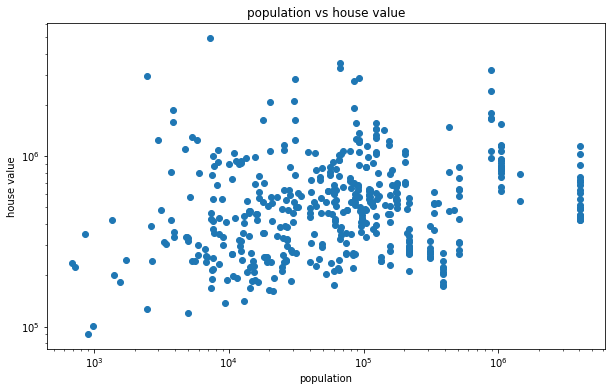

In [19]:
plt.figure(figsize = (10,6))
plt.scatter(crime_df.Population, crime_df.value, cmap = crime_df.indicator)
plt.yscale('log')
plt.xscale('log')
plt.ylabel('house value')
plt.xlabel('population')
plt.title('population vs house value')

## Distance from Downtown
I have created a list that contains the location of downtowns of major cities.

In [20]:
# https://www.cp-dr.com/articles/node-1782
downtown = pd.read_csv('downtown_CA.csv')
downtown

,Name,City,Lat,Lon
0,Downtown San Diago,San Diago,32.717576,-117.166884
1,Financial District,San Francisco,37.793824,-122.401908
2,Downtown Long Beach,Long Beach,33.770684,-118.191437
3,Donwtown Los Angeles,Los Angeles,34.041298,-118.247020
4,Donwtown Fresno,Fresno,36.736965,-119.791542
5,Downtown Pasadena,Pasadena,34.147692,-118.143861
6,Santa Barbara Downtown,Santa Barbara,34.423641,-119.703494
7,Downtown Berkeley,Berkeley,37.869352,-122.269646
8,Downtown Visalia,Visalia,36.330221,-119.297736
9,Downtown San Mateo,San Mateo,37.564110,-122.323481


In [21]:
grouped_df2 = grouped_df[grouped_df['latitude'].notnull()]
grouped_df2.value = grouped_df2.value/grouped_df2.value.max()
m=folium.Map(location=[df2.latitude.mean(),df2.longitude.mean()], tiles='stamentoner', zoom_start=6)
for i in range(len(downtown)):
    folium.Marker([downtown['Lat'][i], downtown['Lon'][i]], popup=downtown['Name'][i]).add_to(m)
plugins.HeatMap(grouped_df2[['latitude','longitude','value']].values.tolist(), radius=10).add_to(m)
display(m)

C:\Users\dy090\anaconda3\lib\site-packages\pandas\core\generic.py:5303: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


Next, I am going to calculate the distance between each property and the nearest downtown.

In [22]:
def distance(lat1, lon1, lat2, lon2):
#     lat1, lon1 = origin
#     lat2, lon2 = destination
    radius = 6371 # km

    dlat = math.radians(lat2-lat1)
    dlon = math.radians(lon2-lon1)
    a = math.sin(dlat/2) * math.sin(dlat/2) + math.cos(math.radians(lat1)) \
        * math.cos(math.radians(lat2)) * math.sin(dlon/2) * math.sin(dlon/2)
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
    d = radius * c

    return d

In [23]:
distance(downtown.Lat[0], downtown.Lon[0], grouped_df2.latitude[0], grouped_df2.longitude[0])

171.99753380169693

In [24]:
grouped_df2 = grouped_df[grouped_df['latitude'].notnull()]
grouped_df2['distance'] = 0
for i in range(len(grouped_df2)):
    k = 0
    for j in range(len(downtown)):
        if j == 0:
            k = distance(downtown.Lat[j], downtown.Lon[j], grouped_df2.latitude[i], grouped_df2.longitude[i])
        else:
            if distance(downtown.Lat[j], downtown.Lon[j], grouped_df2.latitude[i], grouped_df2.longitude[i]) < k:
                k = distance(downtown.Lat[j], downtown.Lon[j], grouped_df2.latitude[i], grouped_df2.longitude[i])
    grouped_df2['distance'][i] = k


C:\Users\dy090\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\dy090\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\dy090\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#r

In [25]:
grouped_df2.indicator.unique()

array(['ZHVI Single-Family Homes Time Series ($)',
       'ZHVI 3-Bedroom Time Series ($)', 'ZHVI 4-Bedroom Time Series ($)',
       'ZHVI 2-Bedroom Time Series ($)',
       'ZHVI Condo/Co-op Time Series ($)',
       'ZHVI 5+ Bedroom Time Series ($)'], dtype=object)

Text(0.5, 1.0, 'distance from downtown vs house value')

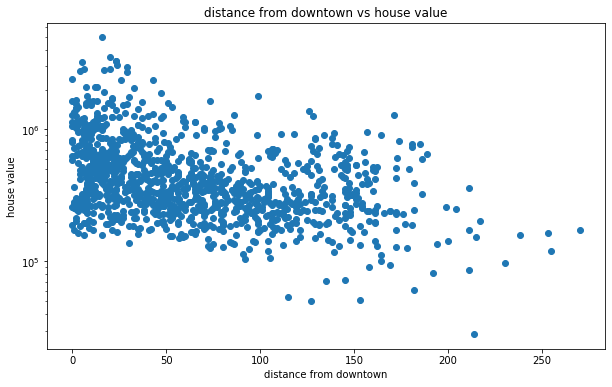

In [26]:
plt.figure(figsize = (10,6))
plt.scatter(grouped_df2.distance, grouped_df2.value, label = i)
plt.yscale('log')
plt.ylabel('house value')
plt.xlabel('distance from downtown')
plt.title('distance from downtown vs house value')
